In [15]:
import pandas as pd
import random
import time
import os
import imp
import cv2
import pickle
import numpy as np
import tqdm as tqdm
from utils import OD_Assemble
import tensorflow as tf
from tqdm import tqdm
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from tensorflow.keras.preprocessing.image import img_to_array,load_img

# optional
# from google.colab.patches import cv2_imshow
from PIL import Image
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
%matplotlib inline

## Results for paper 1 for efficeientdet data

In [5]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
MODEL_LIST = os.listdir('../annotations/ensemble_outputs/efficientdet_d1/allbox')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/efficientdet_d1/allbox/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)
MODEL_LIST,predictions_dict.keys()

(['efficientdet_d1_BBOX.pkl'], dict_keys([0]))

In [ ]:
def calculations2(combine,n_model):
    results = list()
    for i in tqdm(range(df.shape[0])):
    # for i in tqdm(range(100)):
        fname,bboxes,scores,classes = combine.single_model(location=i,model=n_model)
        if scores:
            for j in range(len(scores)):
                results.append([fname,*bboxes[j],scores[j],classes[j],1])
        else:
            results.append([fname,*[0]*6,0])
    return pd.pandas.DataFrame(results,columns=['filename','xmin','ymin','xmax','ymax','score','class','status'])

In [ ]:
main_directory = "../annotations/ensemble_outputs/faster_rcnn_resnet50_v1_640x640_Single/"
os.mkdir(main_directory)
with open(main_directory+'faster_rcnn_resnet50_v1_640x640_DF.pickle','wb') as f:
    pickle.dump(result_data,f)
    f.close()
with open(main_directory+'faster_rcnn_resnet50_v1_640x640_DF.pickle','rb') as f:
    result_data = pickle.load(f)    
    f.close()
result_data

In [ ]:
imp.reload(OD_Assemble)
# def __init__(self,indexes=[0,1,2],con_thresh=0.6,iou_thresh=0.55): defalut
combine = OD_Assemble.NCombiner(con_thresh=0.5)
result_data = calculations2(combine,1)
result_data

In [ ]:
result_data.status.value_counts()

In [ ]:
cat_index = dict()
for i,d in category_index.items():
    cat_index[d['id']] = d['name']
cat_index[0]='NA'
cat_index

In [ ]:
result_data = result_data.merge(df[['filename','width','height']],on='filename',how='left')
result_data['x1'] = result_data['xmin']*result_data['width']
result_data['x2'] = result_data['xmax']*result_data['width']
result_data['y1'] = result_data['ymin']*result_data['height']
result_data['y2'] = result_data['ymax']*result_data['height']
result_data[['x1','x2','y1','y2']] = result_data[['x1','x2','y1','y2']].astype(int)
result_data['classname'] = result_data['class'].map(cat_index)
result_data

In [ ]:
main_directory = "../annotations/ensemble_outputs/faster_rcnn_resnet50_v1_640x640_Single/"
os.mkdir(main_directory)
with open(main_directory+'faster_rcnn_resnet50_v1_640x640_DF.pickle','wb') as f:
    pickle.dump(result_data,f)
    f.close()
with open(main_directory+'faster_rcnn_resnet50_v1_640x640_DF.pickle','rb') as f:
    result_data = pickle.load(f)    
    f.close()
result_data

----

## Results for paper 1 for real world images

In [2]:
PATH_TO_SAVED_MODEL_1 = "../exported-models/faster_rcnn_resnet101_v1_640x640/saved_model"
PATH_TO_SAVED_MODEL_2 = "../exported-models/faster_rcnn_resnet152_v1_640x640/saved_model"
PATH_TO_SAVED_MODEL_3 = "../exported-models/faster_rcnn_resnet101_v1_1024x1024/saved_model"

PATH_TO_LABELS = "../annotations/label_map.pbtxt"

print('Loading Model...')
start_time = time.time()
loaded_model_1 = tf.saved_model.load(PATH_TO_SAVED_MODEL_1)
loaded_model_2 = tf.saved_model.load(PATH_TO_SAVED_MODEL_2)
loaded_model_3 = tf.saved_model.load(PATH_TO_SAVED_MODEL_3)
print('Model loaded, pbtxt loading....')
# Loading the pbtxt
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

print('Done! Took {} seconds'.format(time.time() - start_time))

Loading Model...
Model loaded, pbtxt loading....
Done! Took 162.65588974952698 seconds


In [4]:
print(viz_utils)

<module 'object_detection.utils.visualization_utils' from 'c:\\Users\\magic\\anaconda3\\envs\\tfod3\\lib\\site-packages\\object_detection\\utils\\visualization_utils.py'>


In [6]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')

In [ ]:
# IMG_20220510_170821.jpg - 2
# IMG_20220611_191441 - 1
# IMG_20220605_205210 -3

# WhatsApp Image 2022-08-04 at 11.32.08 AM.jpeg - 2
# WhatsApp Image 2022-08-04 at 11.34.17 AM.jpeg
# WhatsApp Image 2022-08-04 at 11.34.56 AM.jpeg - 1
# WhatsApp Image 2022-08-04 at 11.36.54 AM.jpeg - 2
# WhatsApp Image 2022-08-04 at 11.39.26 AM.jpeg - 1

Done! Took 5.959577560424805 seconds


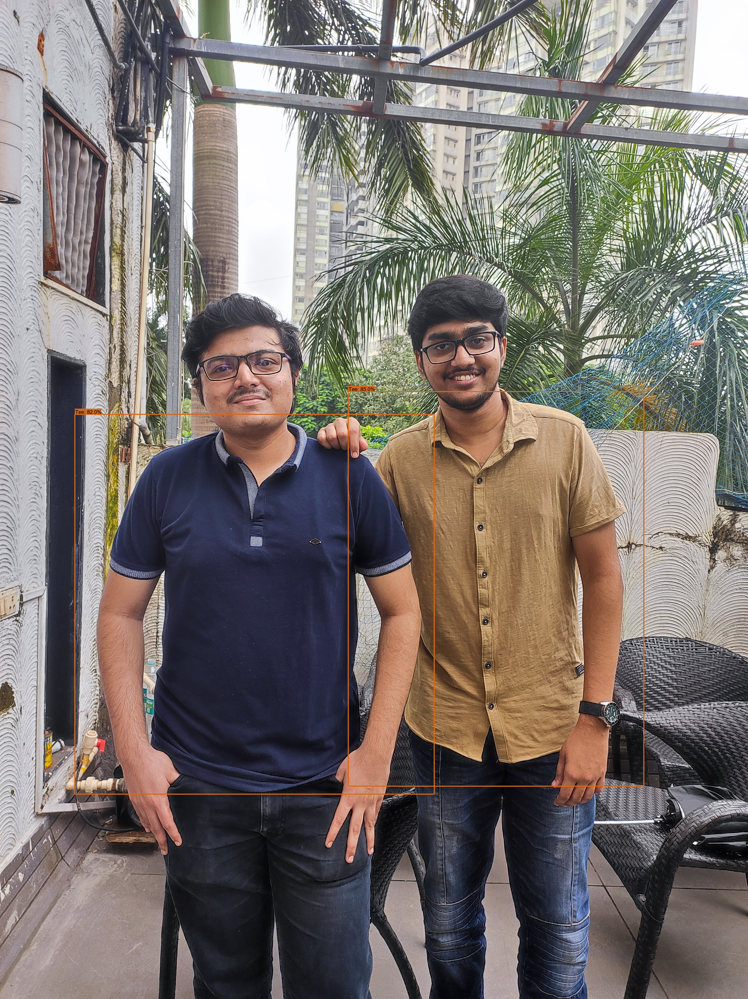

In [7]:
start_time = time.time()
# imagename = 'test_imgs/aish/WhatsApp Image 2022-08-04 at 11.39.26 AM.jpeg'
imagename = 'test_imgs/IMG_20210927_162711.jpg'
test_image_o = cv2.imread(imagename)
test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
test_image_tensor = tf.cast(test_image_tensor, tf.uint8)

with tf.device('/cpu:0'):
    prediction = loaded_model_3(test_image_tensor)


num_detections = int(prediction.pop('num_detections'))
prediction = {key: value[0, :num_detections].numpy()
              for key, value in prediction.items()}
prediction['num_detections'] = num_detections
prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
print('Done! Took {} seconds'.format(time.time() - start_time))
# prediction
image_with_detections = test_image_rgb.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_with_detections,
    prediction['detection_boxes'],
    prediction['detection_classes'],
    prediction['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    min_score_thresh=0.6,
    line_thickness=5)
cv2.imwrite('test_imgs/realworldformam/shar2.jpg',cv2.cvtColor(image_with_detections, cv2.COLOR_RGB2BGR))
Image.fromarray(image_with_detections)

In [8]:
category_index

{1: {'id': 1, 'name': 'Blazer'},
 2: {'id': 2, 'name': 'Blouse'},
 3: {'id': 3, 'name': 'Cardigan'},
 4: {'id': 4, 'name': 'Dress'},
 5: {'id': 5, 'name': 'Jacket'},
 6: {'id': 6, 'name': 'Jeans'},
 7: {'id': 7, 'name': 'Romper'},
 8: {'id': 8, 'name': 'Shorts'},
 9: {'id': 9, 'name': 'Skirt'},
 10: {'id': 10, 'name': 'Sweater'},
 11: {'id': 11, 'name': 'Tank'},
 12: {'id': 12, 'name': 'Tee'},
 13: {'id': 13, 'name': 'Top'}}

In [144]:
# prediction['detection_scores'][0] = 0.1
prediction['detection_scores'][1] = 0.49

In [141]:
prediction['detection_scores']

array([1.00000001e-01, 2.25507140e-01, 8.17246884e-02, 7.60175511e-02,
       6.51378930e-02, 5.40317148e-02, 5.19540533e-02, 3.84827778e-02,
       3.62045690e-02, 3.20247449e-02, 2.08194647e-02, 1.97975636e-02,
       1.96194146e-02, 1.86396874e-02, 1.78288296e-02, 1.62124969e-02,
       1.50980316e-02, 1.50921084e-02, 1.47848986e-02, 1.38273155e-02,
       1.36582265e-02, 1.31280255e-02, 1.09939752e-02, 1.08784940e-02,
       1.06285457e-02, 9.48264636e-03, 9.07873921e-03, 8.95771105e-03,
       8.94029718e-03, 8.48495681e-03, 8.47504009e-03, 8.24987795e-03,
       7.99629372e-03, 7.32929586e-03, 6.81362115e-03, 6.25427859e-03,
       5.72010828e-03, 5.59460558e-03, 5.38884895e-03, 5.32458443e-03,
       5.21117868e-03, 4.99615353e-03, 4.69476217e-03, 4.61703679e-03,
       4.32481896e-03, 4.23529884e-03, 3.94778699e-03, 3.72706843e-03,
       3.55980243e-03, 3.41637991e-03, 3.40023264e-03, 3.36452946e-03,
       3.28724226e-03, 3.23884562e-03, 3.18573834e-03, 3.08082625e-03,
      

----

## Results for Paper 1 for side by side compaisons

In [9]:
PATH_TO_SAVED_MODEL_1 = "../exported-models/faster_rcnn_resnet101_v1_640x640/saved_model"
PATH_TO_SAVED_MODEL_2 = "../exported-models/faster_rcnn_resnet152_v1_640x640/saved_model"
PATH_TO_SAVED_MODEL_3 = "../exported-models/faster_rcnn_resnet101_v1_1024x1024/saved_model"

PATH_TO_LABELS = "../annotations/label_map.pbtxt"

print('Loading Model...')
start_time = time.time()
loaded_model_1 = tf.saved_model.load(PATH_TO_SAVED_MODEL_1)
loaded_model_2 = tf.saved_model.load(PATH_TO_SAVED_MODEL_2)
loaded_model_3 = tf.saved_model.load(PATH_TO_SAVED_MODEL_3)
print('Model loaded, pbtxt loading....')
# Loading the pbtxt
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

print('Done! Took {} seconds'.format(time.time() - start_time))

Loading Model...
Model loaded, pbtxt loading....
Done! Took 165.61819434165955 seconds


In [9]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
MODEL_LIST = os.listdir('../annotations/ensemble_outputs/single_model_preds')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)
MODEL_LIST,predictions_dict.keys()

(['centernet_resnet101_v1_512x512_BBOX.pkl',
  'efficientdet_d1_BBOX.pkl',
  'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
  'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
  'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
  'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
  'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
  'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
  'ssd_resnet152_v1_fpn_640x640.pkl'],
 dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8]))

In [11]:
def show_inference(model,frame):
      test_image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
      # OpenCV reads images in BGR format. So for us to work we need RGB format.
      test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)

      test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
      test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.

      
      # Predictions
      with tf.device('/cpu:0'):
            prediction = model(test_image_tensor)
        
      num_bboxes = int(prediction.pop('num_detections'))
      prediction = {key: value[0, :num_bboxes].numpy() for key, value in prediction.items()}
      prediction['num_detections'] = num_bboxes
          
      # detection_classes should be ints.
      prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
              

      image_with_detections = test_image_rgb.copy()
      viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            prediction['detection_boxes'],
            prediction['detection_classes'],
            prediction['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
      # return cv2.cvtColor(image_with_detections, cv2.COLOR_RGB2BGR)
      return image_with_detections
      # return prediction,prediction2
      
def show_inference2(model,test_image_o):
      # imagename = 'test_imgs/IMG_20210927_162711.jpg'
      
      test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
      test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
      test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
      test_image_tensor = tf.cast(test_image_tensor, tf.uint8)

      with tf.device('/cpu:0'):
          prediction = model(test_image_tensor)


      num_detections = int(prediction.pop('num_detections'))
      prediction = {key: value[0, :num_detections].numpy()
                    for key, value in prediction.items()}
      prediction['num_detections'] = num_detections
      prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
      # print('Done! Took {} seconds'.format(time.time() - start_time))
      # prediction
      image_with_detections = test_image_rgb.copy()
      viz_utils.visualize_boxes_and_labels_on_image_array(
          image_with_detections,
          prediction['detection_boxes'],
          prediction['detection_classes'],
          prediction['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          min_score_thresh=0.6,
          line_thickness=15)
      return image_with_detections

### Results from test data

100%|██████████| 1/1 [00:02<00:00,  2.64s/it]


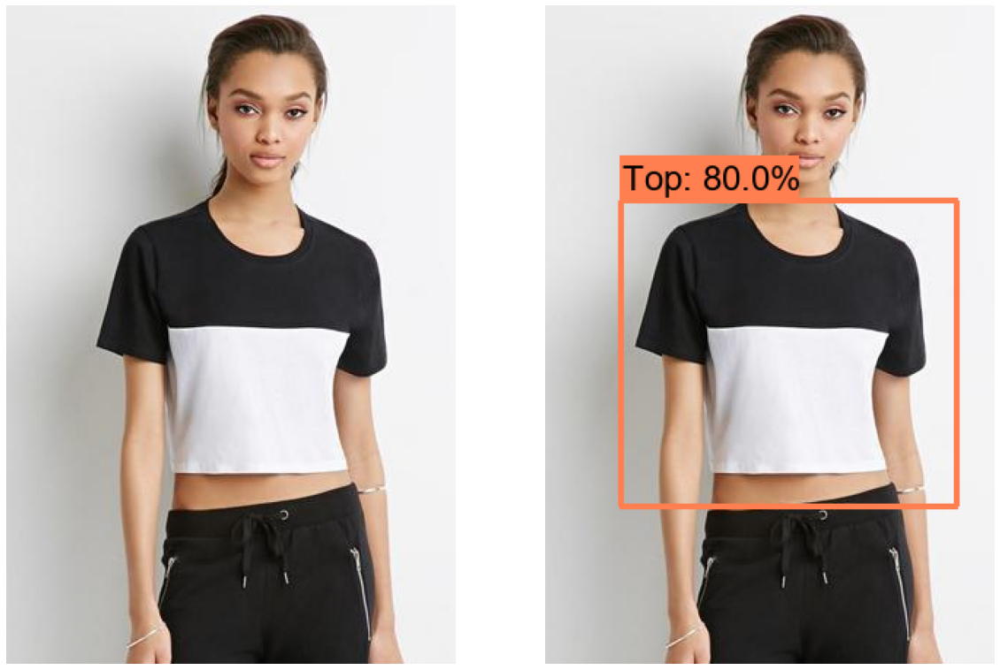

In [44]:
plt.figure(figsize=(20,20))
samples = 1
for cls_id in tqdm(range(13,len(category_index)+1)):
    d=df[df['classn']==cls_id].sample(1).iloc[0]
    test_image_o = cv2.imread('../'+d['filename'])
    
    inference = show_inference(loaded_model_1,test_image_o)
    # inference = show_inference2(loaded_model_1,test_image_o)
    
    x1,y1,x2,y2 = d[['xmin','ymin','xmax','ymax']].values
    # grndimg = cv2.rectangle(test_image_o,(x1,y1),(x2,y2),(255, 0, 0), 2)
    
    plt.subplot(samples,2,2)
    plt.axis('off')
    plt.imshow(inference)

    
    p = plt.subplot(samples,2,1)
    plt.axis('off')
    plt.imshow(cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB))
    # plt.text(0.5,-0.05, d['class'], size=12, ha="center",transform=p.transAxes)
    plt.savefig('outputs/paper 1/'+d['class']+'.png', bbox_inches='tight')
#     break
# plt.show()

### Results from real world data

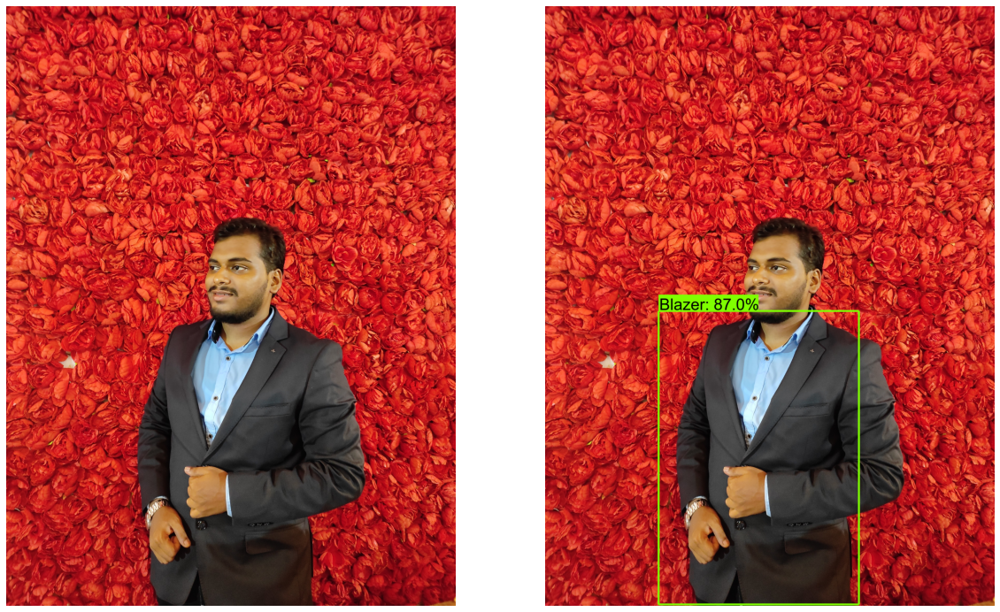

In [16]:
imp.reload(viz_utils)
test_image_o = cv2.imread('test_imgs/new/IMG_20220605_205210.jpg')
inference = show_inference2(loaded_model_3,test_image_o)
plt.figure(figsize=(20,20))    
samples = 1

plt.subplot(samples,2,2)
plt.axis('off')
plt.imshow(inference)

p = plt.subplot(samples,2,1)
plt.axis('off')
plt.imshow(cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB))
# plt.text(0.5,-0.05, d['class'], size=12, ha="center",transform=p.transAxes)
plt.savefig('outputs/paper 1/testimg3.png', bbox_inches='tight')

In [14]:
df[df['classn']==1].sample(1).iloc[0]['filename']

'img/Button-Front_Blazer/img_00000021.jpg'

## Results for paper 1 for matrix data

In [6]:
PATH_TO_SAVED_MODEL_1 = "../exported-models/faster_rcnn_resnet101_v1_640x640/saved_model"
PATH_TO_SAVED_MODEL_2 = "../exported-models/faster_rcnn_resnet152_v1_640x640/saved_model"
PATH_TO_SAVED_MODEL_3 = "../exported-models/faster_rcnn_resnet101_v1_1024x1024/saved_model"

PATH_TO_LABELS = "../annotations/label_map.pbtxt"

print('Loading Model...')
start_time = time.time()
loaded_model_1 = tf.saved_model.load(PATH_TO_SAVED_MODEL_1)
loaded_model_2 = tf.saved_model.load(PATH_TO_SAVED_MODEL_2)
loaded_model_3 = tf.saved_model.load(PATH_TO_SAVED_MODEL_3)
print('Model loaded, pbtxt loading....')
# Loading the pbtxt
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

print('Done! Took {} seconds'.format(time.time() - start_time))

['centernet_resnet101_v1_512x512_BBOX.pkl',
 'efficientdet_d1_BBOX.pkl',
 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
 'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
 'ssd_resnet152_v1_fpn_640x640.pkl']

In [5]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')

In [10]:
def show_inference(model,frame):
      test_image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
      test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
      test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
      test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.
      with tf.device('/cpu:0'):
            prediction = model(test_image_tensor)
      num_bboxes = int(prediction.pop('num_detections'))
      prediction = {key: value[0, :num_bboxes].numpy() for key, value in prediction.items()}
      prediction['num_detections'] = num_bboxes
      # detection_classes should be ints.
      prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)

      image_with_detections = test_image_rgb.copy()
      viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            prediction['detection_boxes'],
            prediction['detection_classes'],
            prediction['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
      return image_with_detections

In [13]:
category_index

{1: {'id': 1, 'name': 'Blazer'},
 2: {'id': 2, 'name': 'Blouse'},
 3: {'id': 3, 'name': 'Cardigan'},
 4: {'id': 4, 'name': 'Dress'},
 5: {'id': 5, 'name': 'Jacket'},
 6: {'id': 6, 'name': 'Jeans'},
 7: {'id': 7, 'name': 'Romper'},
 8: {'id': 8, 'name': 'Shorts'},
 9: {'id': 9, 'name': 'Skirt'},
 10: {'id': 10, 'name': 'Sweater'},
 11: {'id': 11, 'name': 'Tank'},
 12: {'id': 12, 'name': 'Tee'},
 13: {'id': 13, 'name': 'Top'}}

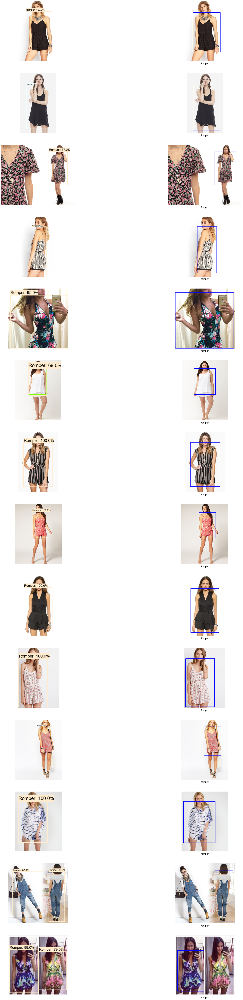

In [24]:
plt.figure(figsize=(30,100))
samples = 14
temp_df = df[df['classn']==7].sample(samples)
for i,d in temp_df.reset_index().iterrows():
# for i,d in df.sample(samples).reset_index().iterrows():
    test_image_o = cv2.imread('../'+d['filename'])
    
    inference = show_inference(loaded_model_1,test_image_o)
    
    x1,y1,x2,y2 = d[['xmin','ymin','xmax','ymax']].values
    grndimg = cv2.rectangle(test_image_o,(x1,y1),(x2,y2),(255, 0, 0), 2)
    
    plt.subplot(samples,2,i*2+1)
    plt.axis('off')
    plt.imshow(inference)

    
    p = plt.subplot(samples,2,i*2+2)
    plt.axis('off')
    plt.imshow(cv2.cvtColor(grndimg, cv2.COLOR_BGR2RGB))
    plt.text(0.5,-0.05, d['class'], size=12, ha="center",transform=p.transAxes)
plt.savefig('outputs/paper 1/matrix/romper3.png', bbox_inches='tight')
plt.show()

## Results for Paper 2 single class milti model

In [2]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
MODEL_LIST = os.listdir('../annotations/ensemble_outputs/single_model_preds')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)
MODEL_LIST

['centernet_resnet101_v1_512x512_BBOX.pkl',
 'efficientdet_d1_BBOX.pkl',
 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
 'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
 'ssd_resnet152_v1_fpn_640x640.pkl']

In [3]:
def show_inference(frame,location=0,model=0):
    
    prediction = predictions_dict[model][location]
    test_image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
    test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
    test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.
    
    prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
    image_with_detections = test_image_rgb.copy()
    
    viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            prediction['detection_boxes'],
            prediction['detection_classes'],
            prediction['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
    return image_with_detections

In [10]:
imp.reload(OD_Assemble)
nmodels = [2,3,4,5,6,7]
combine = OD_Assemble.NCombiner(indexes=nmodels,con_thresh=0.5,iou_thresh=0.6)

In [48]:
samples = 5
for class_no in tqdm(range(1,14)):
    plt.figure(figsize=(25*len(nmodels),16*samples))

    # cols = ['Ensemble','Groundtruth']
    cols = ['Groundtruth']
    cols.extend([MODEL_LIST[mdl] for mdl in nmodels])

    fig, axes = plt.subplots(nrows=samples, ncols=len(nmodels)+1, figsize=(20*len(nmodels),16*samples))
    fig.patch.set_facecolor('white')

    for ax, col in zip(axes[0], cols):
        ax.set_title(col,fontdict={'fontsize':33,'color':'black'})

    temp_df = df[df['classn']==class_no].sample(samples)
    for i,d in enumerate(temp_df.iterrows()):
        test_image_o = cv2.imread('../'+d[1]['filename'])

        # axs = axes[i][0]
        # image_with_detections = combine.Wfb(location=loc,operator=2,visualize=1)
        # axs.imshow(image_with_detections)
        # axs.set_yticks([])
        # axs.set_xticks([])

        img_copy = test_image_o.copy()
        x1,y1,x2,y2 = d[1][['xmin','ymin','xmax','ymax']].values
        grndimg = cv2.rectangle(img_copy,(x1,y1),(x2,y2),(255, 0, 0), 2)

        axs = axes[i][0]
        axs.imshow(cv2.cvtColor(grndimg, cv2.COLOR_BGR2RGB))
        axs.text(0.5,-0.05, d[1]['class'], size=40, color='black', ha="center",transform=axs.transAxes)
        axs.set_yticks([])
        axs.set_xticks([])

        for j in range(len(nmodels)):
            axs = axes[i][j+1]
            modl = nmodels[j]
            inference = show_inference(test_image_o,d[0],modl)
            axs.imshow(inference)
            axs.set_yticks([])
            axs.set_xticks([])
    cat_name = category_index[class_no]['name']
    plt.savefig('outputs/paper 2/single class multi model without ensemble/'+cat_name+'/'+cat_name+'2.png', bbox_inches='tight',dpi=100,facecolor=fig.get_facecolor())
    plt.close(fig)
    # print(class_no,'fig saved')
    # plt.show()

100%|██████████| 13/13 [02:55<00:00, 13.48s/it]


<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

<Figure size 10800x5760 with 0 Axes>

In [47]:
for a,b in category_index.items():
    os.makedirs('outputs/paper 2/single class multi model without ensemble/'+b['name'],exist_ok=True)